In [8]:
## STANDARD PYTHON LIBS
import os
import sys
import mpld3
import numpy as np
import skimage.io
import matplotlib.pyplot as plt
%matplotlib inline
mpld3.enable_notebook()

## ADDING TO ROOT
ROOT_DIR = os.path.abspath(os.path.join(os.getcwd(), '../../'))
sys.path.append(ROOT_DIR)

## CUSTOM LIBS
import src.utils as utils
import src.model as modellib
from src.config import Config
import src.visualize as visualize
import src.mapillary as mapillary

# GPU LIBS
import keras
import tensorflow as tf

cuda_version = os.popen("cat /usr/local/cuda/version.txt ").read()
print ('TF : ', tf.__version__, '  Keras : ', keras.__version__, '  CUDA : ', cuda_version)

# if utils.check_gpu(verbose=0):
#     pass
# else:
#     sys.exit(1)

TF :  1.6.0   Keras :  2.1.4   CUDA :  CUDA Version 9.0.176



# INFERENCE MODEL

In [2]:
MODEL_DIR = os.path.join(ROOT_DIR, 'demo', 'model', 'logs')
class InferenceConfig(mapillary.MapillaryConfig):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

inference_config = InferenceConfig()
print (' - Batch Size : ', inference_config.BATCH_SIZE)
model = modellib.MaskRCNN(mode="inference", config=inference_config, model_dir=MODEL_DIR)
model_path = model.find_last()[1]
print (' - Model Path : ', model_path)

if model_path != None:
    model.load_weights(model_path, by_name=True)
else:
    sys.exit(1)

 - Batch Size :  1
 - Model Path :  /home/play/playment/production/Mask_RCNN/demo/model/logs/mapillary20180315T0317/mask_rcnn_mapillary_0083.h5


# PILOT DATASET

In [15]:
## OPTION1
import pprint
if __name__ == "__main__":
    url_dataset = '/home/play/GOD_DATASET/open_datasets/mapillary'
    mapillary_mapper = '/home/play/playment/production/Mask_RCNN/demo/raw/merge__cityscapes_mapillary_v2.json'
    mapillary_config = mapillary.MapillaryConfig()
    testData = mapillary.MapillaryDataset(url_dataset, mapillary_mapper, mapillary_config, data_type = 'test')
    pprint.pprint ({each[0] : each[1] for each in zip (testData.class_ids, testData.class_names)})

Mode : test has 5000 images
{0: 'BG',
 1: 'vehicle-car',
 2: 'vehicle-caravan',
 3: 'vehicle-truck',
 4: 'vehicle-bus',
 5: 'vehicle-trailer',
 6: 'vehicle-motorcycle',
 7: 'vehicle-bicycle',
 8: 'vehicle-train',
 9: 'flat-sidewalk',
 10: 'human-person',
 11: 'human-rider',
 12: 'sky',
 13: 'object-pole',
 14: 'void-ego-vehicle'}


/usr/local/lib/python3.5/dist-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


{1: 245, 3: 4, 4: 9, 6: 1, 9: 207, 10: 9, 11: 2, 12: 113, 13: 420, 14: 8}


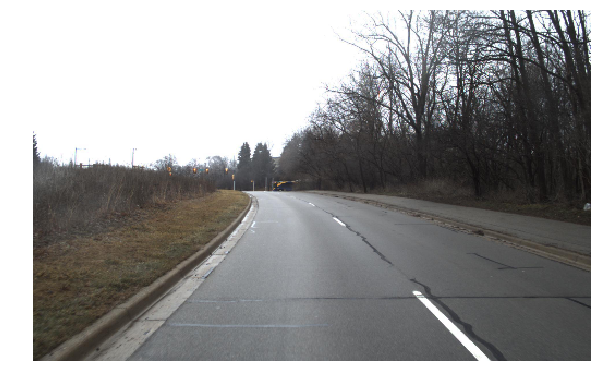

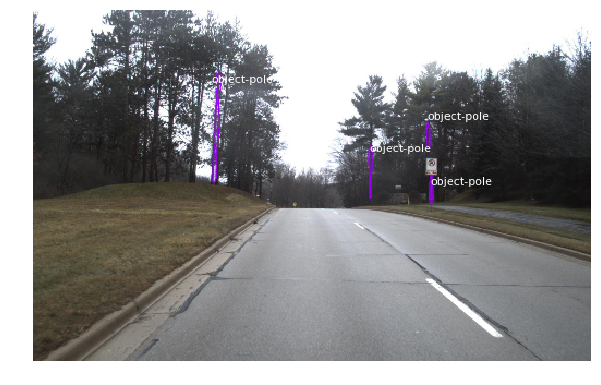

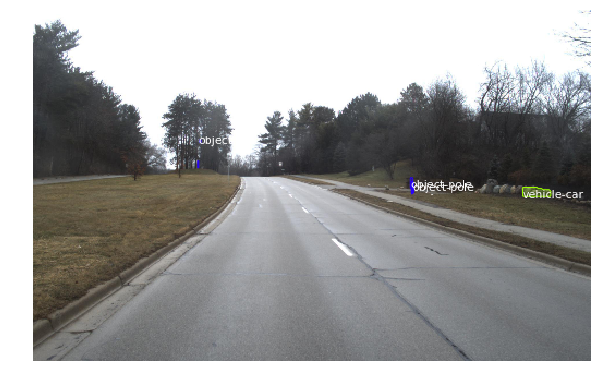

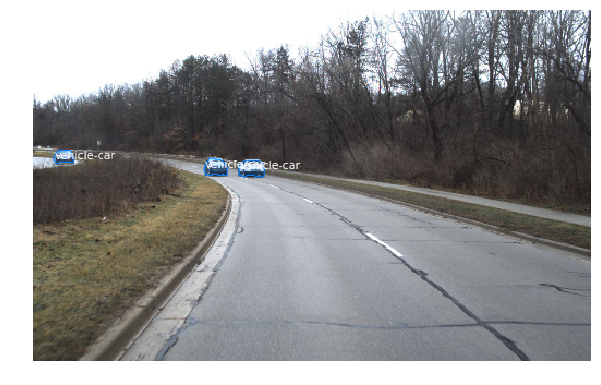

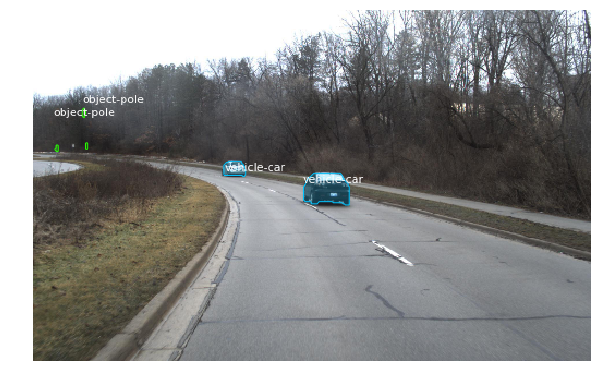

...

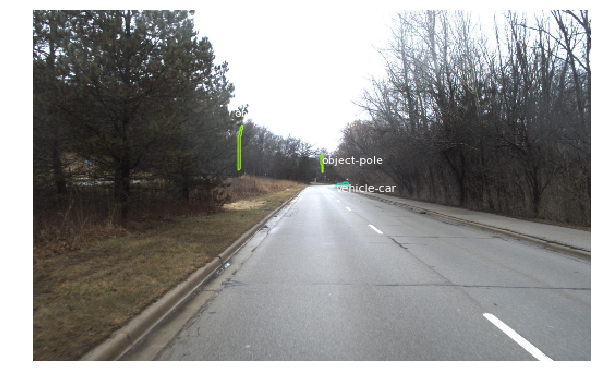

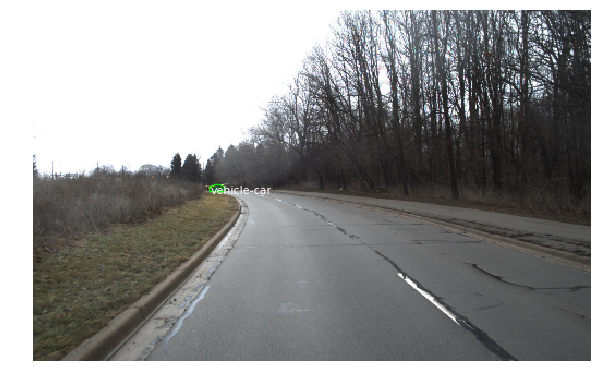

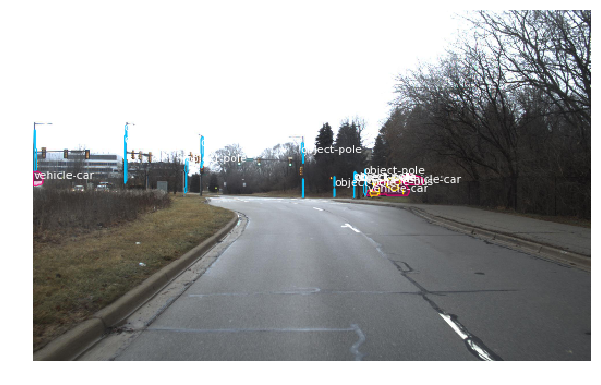

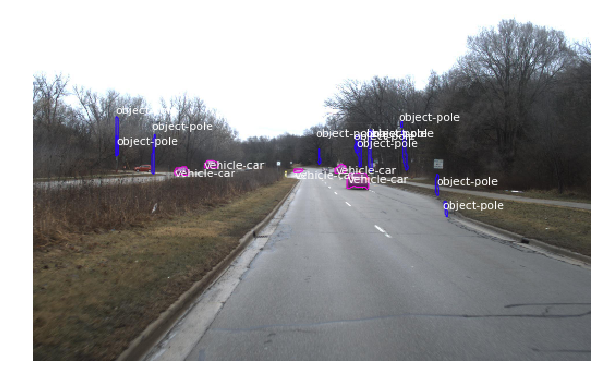

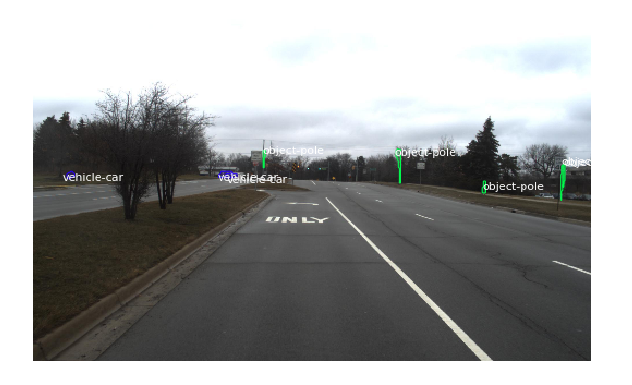

In [ ]:
if 'src.visualize' in sys.modules : del sys.modules['src.visualize']
import src.visualize as visualize

dir_toyota      = '../raw/data/toyota/data/data_pilot'
dir_toyota_save = '../raw/data/toyota/data/data_pilot_mask'
res = {}
show = True
for i, img_name in enumerate(os.listdir(dir_toyota)):
    # if i != 12 : continue 
    img_url = os.path.join(dir_toyota, img_name)
    img     = skimage.io.imread(img_url)
    img     = utils.helper_resize_image(img, 512)
    result = model.detect([img])[0]
    for class_id in result['class_ids']:
        if class_id in res : res[class_id] += 1
        else               : res[class_id] = 1
    if show :             
        visualize.display_instances_play(img, result['rois'], result['masks'], result['class_ids'], testData.class_names, result['scores']
                            , show_boxes = False
                            , save_fig = True, save_url = os.path.join(dir_toyota_save, '{0}.jpg'.format(i+1))
                            , class_ids_exclude = [9, 12])
    # break

pprint.pprint(res)